## Most relevant conclussions from the first iteration EDA

**Sellers**
1. Sellers with a recent creation date perceive no improvement in average delivery days for their orders compared to older sellers.
2. Given the sellers' focus on working with different clients, a low repurchase level is expected due to a positive correlation between the number of orders and the number of clients. Only one seller appears to have a solid base of existing clients.
3. There is no correlation between total earnings and the total number of categories in which sellers have sold their products. This suggests a lack of specialization in a specific category, which is further supported by the correlation between shared products and total categories.
4. Sellers with a recent creation date do not exhibit higher earnings per order or a higher client price on average compared to older sellers.

**Target Variable**
1. The average client price for non-churned sellers was 13% higher compared to churned sellers. However, when considering average effective earnings, the increase is substantial at 88%.
2. The target variable exhibits an imbalance, with approximately 10% of the dataset generating orders in the last month. Preprocessing techniques should be applied to address this issue.
3. Several variables display significant correlations. Depending on the chosen models, some of these variables should be dropped or considered during model selection to mitigate multicollinearity.

In [14]:
# Importing the libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [15]:
#Plotting:
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.express as px

In [16]:
dfsellers8 = pd.read_csv("../data/elenas-it1-preprocessed3.csv", index_col=0)
dfsellers8['created_at'] = pd.to_datetime(dfsellers8['created_at'])
dfsellers8.drop(["number_of_photos"], axis=1, inplace=True)


In [17]:
print(dfsellers8.columns)
print(dfsellers8.dtypes)

Index(['Unnamed: 0', 'seller_id', 'created_at', 'user_id', 'total_orders',
       'effective_ratio', 'rto_ratio', 'return_ratio', 'cancelled_ratio',
       'departments_sold', 'number_of_clients', 'avg_effective_delivery_days',
       'total_effective_earnings', 'avg_effective_earnings',
       'avg_client_price', 'avg_shipment_cost', 'total_discount',
       'avg_discount', 'order_last_month', 'has_referred', 'avg_cart_items',
       'avg_vendor_discount', 'number_of_products', 'number_of_categories',
       'average_prod_existence_days', 'total_products_shared',
       'number_of_credits', 'number_of_used_credits', 'avg_credit_amount',
       'number_of_vouchers'],
      dtype='object')
Unnamed: 0                              int64
seller_id                               int64
created_at                     datetime64[ns]
user_id                                 int64
total_orders                          float64
effective_ratio                       float64
rto_ratio                 

In [18]:
def num_vis(df, row, col, colorp):
    # Initialization with the rows and columns for the subplot
    fig = make_subplots(rows=row, cols=col)
    
    # List of the numerical columns
    numeric_columns = df.select_dtypes(exclude=["object"]).columns.to_list()
    
    # Loop, iterating on each column
    for i, column in enumerate(numeric_columns):
        # Number of rows based on index
        row_num = (i // col) + 1
        # Number of columns based on index, + 1 to start on the first position and have an integer
        col_num = (i % col) + 1
        
        # Histogram of the variables
        hist = px.histogram(df, x=column, color_discrete_sequence=px.colors.qualitative.Plotly)
        
        fig.add_trace(hist.data[0], row=row_num, col=col_num)
        fig.update_xaxes(title_text=column, row=row_num, col=col_num)
        fig.update_yaxes(title_text="Count", row=row_num, col=col_num)
    
    fig.update_layout(height=400*row, width=400*col)
    fig.show()

#num_vis(dfsellers8.round(1), 6, 6, "RdPu")

In [19]:
#Operational metrics
def boxplot_vis(df, col1=0, col2=0, col3=0, col4=0, col5=0, col6=0):
    # Create subplot with 2 rows and 3 columns
    fig = make_subplots(rows=2, cols=3)

    # Visualization for each value
    if col1 != 0:
        fig.add_trace(px.box(data_frame=df.round(0), y=col1).data[0], row=1, col=1)
        fig.update_xaxes(title_text=col1, row=1, col=1)
        fig.update_yaxes(title_text=input("write the y axis for the plot 1: "), row=1, col=1)
    if col2 != 0:
        fig.add_trace(px.box(data_frame=df.round(0), y=col2).data[0], row=1, col=2)
        fig.update_xaxes(title_text=col2, row=1, col=2)
        fig.update_yaxes(title_text=input("write the y axis for the plot 2: "), row=1, col=2)
    if col3 != 0:
        fig.add_trace(px.box(data_frame=df.round(0), y=col3).data[0], row=1, col=3)
        fig.update_xaxes(title_text=col3, row=1, col=3)
        fig.update_yaxes(title_text=input("write the y axis for the plot 3: "), row=1, col=3)
    if col4 != 0:
        fig.add_trace(px.box(data_frame=df.round(0), y=col4).data[0], row=2, col=1)
        fig.update_xaxes(title_text=col4, row=2, col=1)
        fig.update_yaxes(title_text=input("write the y axis for the plot 4: "), row=2, col=1)
    if col5 != 0:
        fig.add_trace(px.box(data_frame=df.round(0), y=col5).data[0], row=2, col=2)
        fig.update_xaxes(title_text=col5, row=2, col=2)
        fig.update_yaxes(title_text=input("write the y axis for the plot 5: "), row=2, col=2)
    if col6 != 0:
        fig.add_trace(px.box(data_frame=df.round(0), y=col6).data[0], row=2, col=3)
        fig.update_xaxes(title_text=col6, row=2, col=3)
        fig.update_yaxes(title_text=input("write the y axis for the plot 6: "), row=2, col=3)

    # Show the figure
    fig.show()



### Transactional information:

**Earnings**

- On average, the sellers have earned COP 175.000 using Elenas, although this number is not an adequate measure since it combines sellers that have been working for different time periods, and with different usage levels. The maximum a that a seller within this sample has earned is COP 158M which is approximately USD 400K

- There is a neutral correlation between the seller creation date and the average earnings. Meaning that over time, the sellers are not earning more on average. There is an increase in the last months but it is marginal. This can also be confirmed by the correlation of seller creation date and average end client price

- Generally, the sellers despite their creation date use the credits. This can be further confirmed by a correlation of 0.3, suggesting that there is a weak relationship and that other factors may influence more on the number of used credits.

In [20]:
# Credits:
#Boxplots: credits & vouchers

import plotly.express as px

fig = px.box(
    dfsellers8.round(0),
    y="avg_credit_amount"
)

# Update the layout with the title
fig.update_layout(
    title={
        'text': 'Average credit amount (COP): A lot of data variability due to the majority of data points tightly clustered (IQR) and a substantial number of outliers',
        'x': 0.5,
        'y': 0.95,
        'xanchor': 'center',
        'yanchor': 'top',
        'font': {'size': 14}
    }
)

# Show the figure
fig.show()


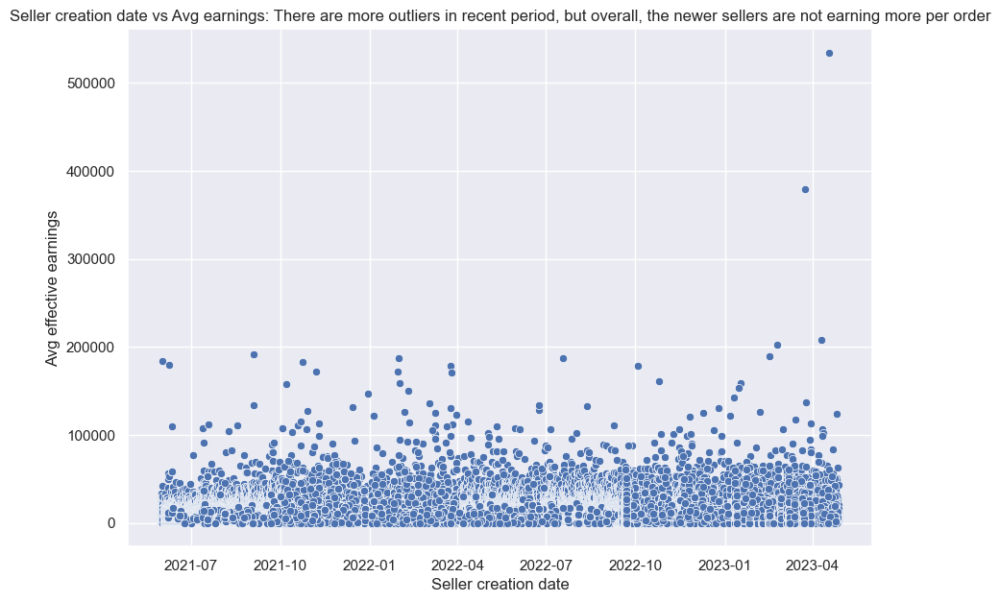

In [21]:
# Set plot style: grey grid in the background
sns.set(style="darkgrid")

# Set the figure size
plt.figure(figsize=(10, 7))

# Create scatter plot
sns.scatterplot(data=dfsellers8, x='created_at', y='avg_effective_earnings')

# Set the title and labels
plt.title('Seller creation date vs Avg earnings: There are more outliers in recent period, but overall, the newer sellers are not earning more per order')
plt.xlabel('Seller creation date')
plt.ylabel('Avg effective earnings')

# Show the plot
plt.show()

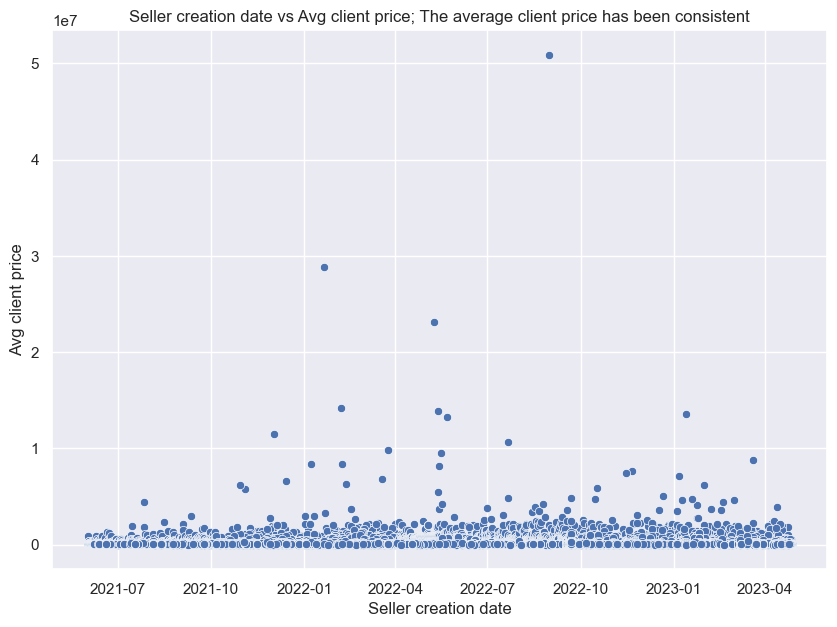

In [22]:
# Set plot style: grey grid in the background
sns.set(style="darkgrid")

# Set the figure size
plt.figure(figsize=(10, 7))

# Create scatter plot
sns.scatterplot(data=dfsellers8, x='created_at', y='avg_client_price')

# Set the title and labels
plt.title('Seller creation date vs Avg client price; The average client price has been consistent')
plt.xlabel('Seller creation date')
plt.ylabel('Avg client price')

# Show the plot
plt.show()

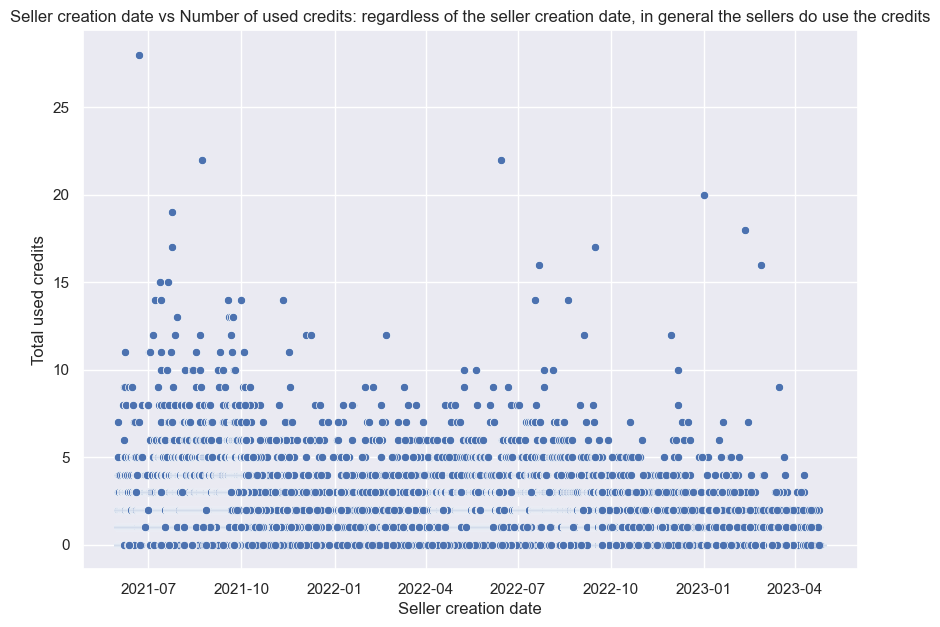

In [23]:
# Set plot style: grey grid in the background
sns.set(style="darkgrid")

# Set the figure size
plt.figure(figsize=(10, 7))

# Create scatter plot
sns.scatterplot(data=dfsellers8, x='created_at', y='number_of_used_credits')

# Set the title and labels
plt.title('Seller creation date vs Number of used credits: regardless of the seller creation date, in general the sellers do use the credits')
plt.xlabel('Seller creation date')
plt.ylabel('Total used credits')

# Show the plot
plt.show()

## Operational columns:

The ratios behave as in a positive but expected pattern, the effective ratio is skewed to the right, meaning that a majority of orders are effective, while the negative ones are skewed to the left, indicating that most orders do not have a negative outcome.

The average delivery days for effecive orders is 5.4 days, which is quite similar to the median.

The sellers with a most recent seller creation date do not experience on average a decrease in the average delivery days

In [12]:
# Create subplot with 1 row and 2 columns
fig = make_subplots(rows=2, cols=2)

# Add box plots to the subplots
fig.add_trace(px.box(data_frame=dfsellers8.round(3), y='effective_ratio').data[0], row=1, col=1)
fig.add_trace(px.box(data_frame=dfsellers8.round(3), y='rto_ratio').data[0], row=1, col=2)
fig.add_trace(px.box(data_frame=dfsellers8.round(3), y='return_ratio').data[0], row=2, col=1)
fig.add_trace(px.box(data_frame=dfsellers8.round(3), y='cancelled_ratio').data[0], row=2, col=2)


# Update layout
fig.update_layout(title='Operational ratios')
fig.update_xaxes(title_text='effective_ratio', row=1, col=1)
fig.update_xaxes(title_text='rto_ratio', row=1, col=2)
fig.update_xaxes(title_text='return_ratio', row=1, col=1)
fig.update_xaxes(title_text='cancelled_ratio', row=1, col=2)
fig.update_yaxes(title_text='Counts', row=1, col=1)
fig.update_yaxes(title_text='Counts', row=1, col=2)
fig.update_yaxes(title_text='Counts', row=2, col=1)
fig.update_yaxes(title_text='Counts', row=2, col=2)

fig.show()

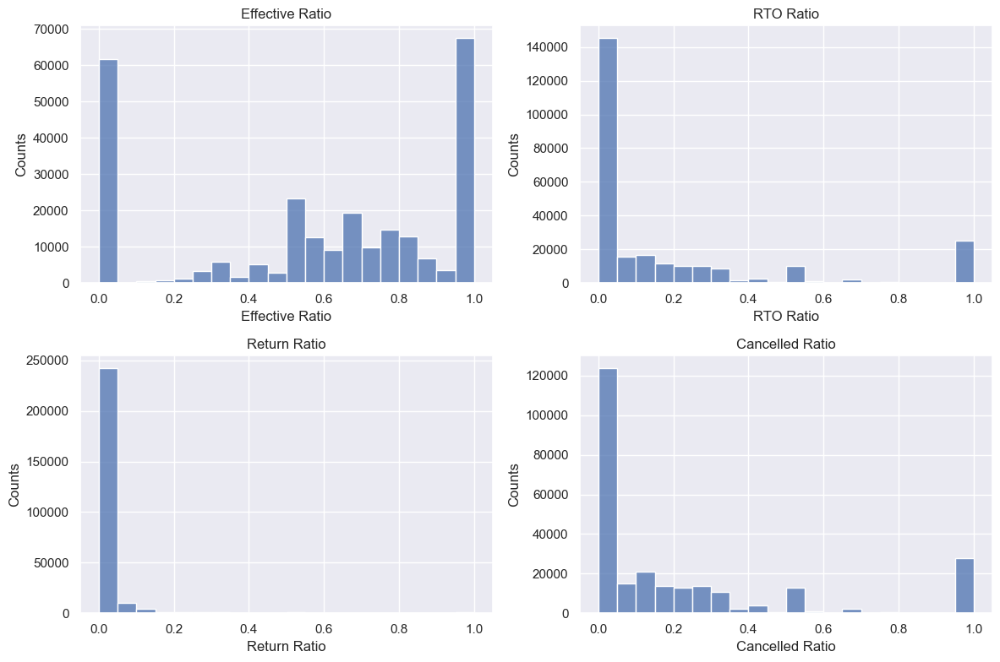

In [6]:
import seaborn as sns
import matplotlib.pyplot as plt

# Create subplot with 1 row and 2 columns
fig, axes = plt.subplots(2, 2, figsize=(12, 8))

# Add histograms to the subplots
sns.histplot(data=dfsellers8.round(3), x='effective_ratio', bins=20, ax=axes[0, 0])
sns.histplot(data=dfsellers8.round(3), x='rto_ratio', bins=20, ax=axes[0, 1])
sns.histplot(data=dfsellers8.round(3), x='return_ratio', bins=20, ax=axes[1, 0])
sns.histplot(data=dfsellers8.round(3), x='cancelled_ratio', bins=20, ax=axes[1, 1])

# Set titles and labels
axes[0, 0].set_title('Effective Ratio')
axes[0, 0].set_xlabel('Effective Ratio')
axes[0, 0].set_ylabel('Counts')

axes[0, 1].set_title('RTO Ratio')
axes[0, 1].set_xlabel('RTO Ratio')
axes[0, 1].set_ylabel('Counts')

axes[1, 0].set_title('Return Ratio')
axes[1, 0].set_xlabel('Return Ratio')
axes[1, 0].set_ylabel('Counts')

axes[1, 1].set_title('Cancelled Ratio')
axes[1, 1].set_xlabel('Cancelled Ratio')
axes[1, 1].set_ylabel('Counts')

# Adjust spacing between subplots
plt.tight_layout()

# Display the plot
plt.show()

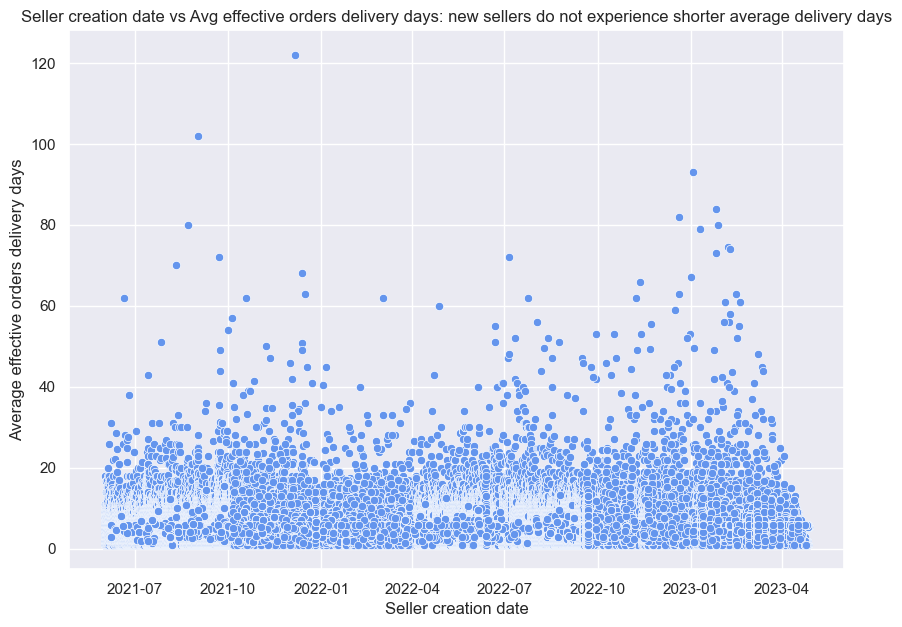

In [5]:
# Set plot style: grey grid in the background
sns.set(style="darkgrid")

# Set the figure size
plt.figure(figsize=(10, 7))

# Scatter plot
scatter = sns.scatterplot(data=dfsellers8, x='created_at', y='avg_effective_delivery_days', color='cornflowerblue')

# Set the title and labels
scatter.set_title('Seller creation date vs Avg effective orders delivery days: new sellers do not experience shorter average delivery days')
scatter.set_xlabel('Seller creation date')
scatter.set_ylabel('Average effective orders delivery days')

# Display the plot
plt.show()

## Behavioral columns

- The sellers focus on working with different clients, the repurchase level has to be low because there is a positive correlation between the number of orders and number of clients. Only 1 appeas to have a solid base of existing clients

- There isn't a clear correlation betwen the total earnings and the total categories where they have sold their products, meaning that they do not tend to specialize on a specific category. This is also seen in the correlation between shared products and total categories


In [10]:
#Relationship between orders and clients

fig = px.scatter(dfsellers8, x='number_of_clients', y='total_orders', title='Total Orders vs Total Clients: positive correlation indicating that they focus on new clients',
                 labels={'total_clients': 'Total Clients', 'total_orders': 'Total Orders'})

fig.update_layout(xaxis_title='Total Clients', yaxis_title='Total Orders')
fig.show()

In [ ]:
#Backup: -> not turned on due to file size: Relationship between earnings and clients

fig = px.scatter(dfsellers8, x='number_of_clients', y='total_effective_earnings', title='Total earnings vs Total Clients',
                 labels={'total_clients': 'Total Clients', 'total_effective_earnings': 'Total effective earnings'})

fig.update_layout(xaxis_title='Total Clients', yaxis_title='Total effective earnings')
fig.show()

In [ ]:
#Backup: -> not turned on due to file size: Relationship between earnings and categories

fig = px.scatter(dfsellers8, x='number_of_categories', y='total_effective_earnings', title='Total categories vs Total earnings',
                 labels={'number_of_categories': 'Total Categories', 'total_effective_earnings': 'Total effective earnings'})

fig.update_layout(xaxis_title='Number of categories', yaxis_title='Total effective earnings')
fig.show()

In [ ]:
#Backup: -> not turned on due to file size: Relationship between product shared and categories

fig = px.scatter(dfsellers8, x='number_of_categories', y='total_products_shared', title='Total categories vs Total number of shared products',
                 labels={'number_of_categories': 'Total Categories', 'total_products_shared': 'Total number of shared products'})

fig.update_layout(xaxis_title='Number of categories', yaxis_title='Total number of shared products')
fig.show()

## Correlations
Several variables display significant correlations. Depending on the chosen models, some of these variables should be dropped or considered during model selection to mitigate multicollinearity.

In [11]:
dfsellers9 = dfsellers8.drop(["total_discount", "avg_discount", "avg_cart_items", "user_id"], axis=1)

Text(0.5, 1.0, 'Correlation matrix')

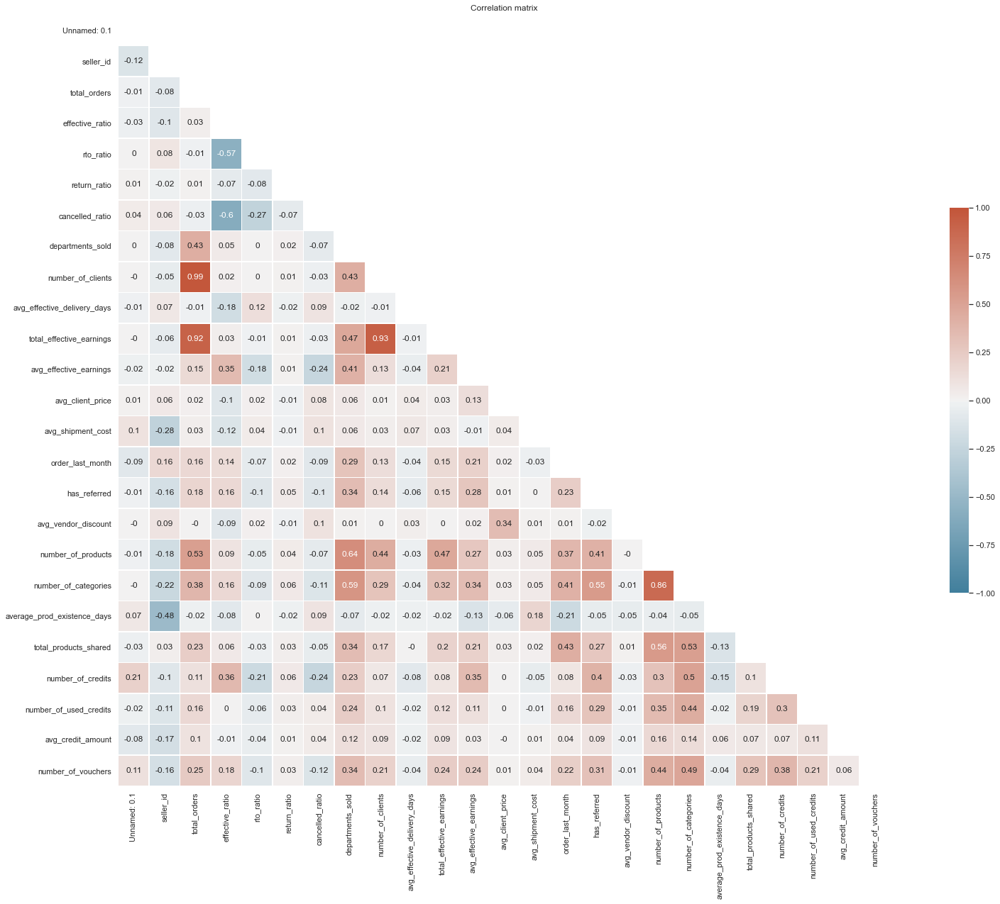

In [12]:
sns.set_theme(style="white")

# Compute the correlation matrix
corr = dfsellers9.corr().round(2)

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(30, 20))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmin=-1, vmax=1, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True)
plt.title("Correlation matrix")

- Some variables have a very high correlation, indicating that the model is prone to multicolinearity which should be adressed on the preprocessing of the model. E.G number of clients, total orders, total effective earnings or the ratios, since they are mutually exclusive.
- Number of used credits and number of credits (assigned) have a correlation of 3

## Target variable:
- The average client price for non-churned sellers was 13% higher compared to churned sellers. However, when considering average effective earnings, the increase is substantial at 88%.
- The target variable exhibits an imbalance, with approximately 10% of the dataset generating orders in the last month. Preprocessing techniques should be applied to address this issue.

In [22]:
#Target variable distribution
dfsellers8["order_last_month"].value_counts()

0    235708
1     27405
Name: order_last_month, dtype: int64

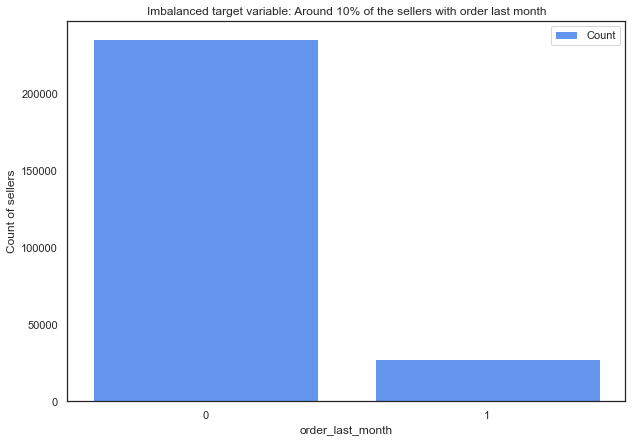

In [13]:
import matplotlib.pyplot as plt

# Calculate the count for each value in order_last_month
counts = dfsellers8['order_last_month'].value_counts().sort_index()

# Set the figure size
plt.figure(figsize=(10, 7))

# Plot a stacked bar chart
bar1 = plt.bar(counts.index.astype(str), counts.values, color='cornflowerblue')

# Set the title and labels
plt.title("Imbalanced target variable: Around 10% of the sellers with order last month")
plt.xlabel("order_last_month")
plt.ylabel("Count of sellers")

# Add a legend
plt.legend([bar1], ['Count'])

# Display the plot
plt.show()



In [14]:
fig = px.box(dfsellers8, x="order_last_month", y="avg_effective_earnings")
fig.update_layout(title='Average effective ticket distribution for target variable')

fig.show()

- The median is almost double for retained sellers, but the Q3 is not as large (COP 9K vs 13K)
- Both of them with a significant number of outliers

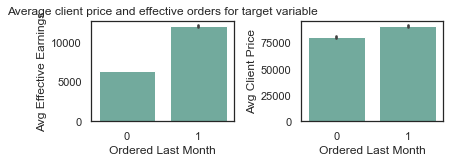

In [15]:
import seaborn as sns
import matplotlib.pyplot as plt

# Create subplots with 2 rows and 2 columns
plt.subplot(2, 2, 1)
# Subplot 1: avg client price vs ordered last month
sns.barplot(
    x="order_last_month",
    y="avg_effective_earnings",
    data=dfsellers8,
    color='#69b3a2')
plt.title("Average client price and effective orders for target variable")
plt.xlabel("Ordered Last Month")
plt.ylabel("Avg Effective Earnings")

plt.subplot(2, 2, 2)
# Subplot 2: avg client price vs ordered last month
sns.barplot(
    x="order_last_month",
    y="avg_client_price",
    data=dfsellers8,
    color='#69b3a2')
#plt.title("Avg Client Price vs Ordered Last Month")
plt.xlabel("Ordered Last Month")
plt.ylabel("Avg Client Price")

plt.tight_layout()  # Adjust subplot spacing

plt.show()


In [16]:
print("AVG effective earnings for target variable")
print(" ")
print(dfsellers8.groupby("order_last_month")["avg_effective_earnings"].mean().round(0))
print("------------------------------------")
print("AVG client price for target variable")
print(" ")
print(dfsellers8.groupby("order_last_month")["avg_client_price"].mean().round(0))

AVG effective earnings for target variable
 
order_last_month
0     6355.0
1    11953.0
Name: avg_effective_earnings, dtype: float64
------------------------------------
AVG client price for target variable
 
order_last_month
0    80132.0
1    90875.0
Name: avg_client_price, dtype: float64


The difference in the average effective earnings per order is substantial for the target variable. The difference on the average client price is also relevant but not as big. 